In [2]:
import numpy as np
import cv2
import os.path as osp
from glob import glob
import matplotlib.pyplot as plt
from IPython.core.debugger import set_trace
from skimage.feature import hog
from skimage import exposure, draw
import matplotlib.lines as mlines
plt.rcParams.update({'figure.max_open_warning': 0})

def load_image(path):
  im = cv2.imread(path)
  im = im[:, :, ::-1]  # BGR -> RGB
  im = im.astype(np.float32)  # for vlfeat functions
  return im

def report_accuracy(confidences, label_vector):
  """
  Calculates various accuracy metrics on the given predictions
  :param confidences: 1D numpy array holding predicted confidence scores
  :param label_vector: 1D numpy array holding ground truth labels (same size
  as confidences
  :return: tp_rate, fp_rate, tn_rate, fn_rate
  """
  preds = confidences.copy()
  preds[preds >= 0] = 1
  preds[preds <  0] = -1

  tp = np.logical_and(preds > 0, preds==label_vector)
  fp = np.logical_and(preds > 0, preds!=label_vector)
  tn = np.logical_and(preds < 0, preds==label_vector)
  fn = np.logical_and(preds < 0, preds!=label_vector)

  N = len(label_vector)

  tp_rate = sum(tp) / (sum(tp)+sum(fn)) * 100
  fp_rate = sum(fp) / (sum(fp)+sum(tn)) * 100
  tn_rate = 100 - fp_rate
  fn_rate = 100 - tp_rate
  accuracy = (sum(tp)+sum(tn)) / N * 100

  print('Accuracy = {:4.3f}%\n'
        'True Positive rate = {:4.3f}%\nFalse Positive rate = {:4.3f}%\n'
        'True Negative rate = {:4.3f}%\nFalse Negative rate = {:4.3f}%'.
    format(accuracy, tp_rate, fp_rate, tn_rate, fn_rate))

  return tp_rate, fp_rate, tn_rate, fn_rate

def voc_ap(rec, prec):
  mrec = np.hstack((0, rec, 1))
  mpre = np.hstack((0, prec, 0))

  for i in reversed(range(len(mpre)-1)):
    mpre[i] = max(mpre[i], mpre[i+1])

  i = np.where(mrec[1:] != mrec[:-1])[0] + 1
  ap = sum((mrec[i] - mrec[i-1]) * mpre[i])
  return ap

def evaluate_detections(bboxes, confidences, image_ids, label_path, draw=True):
  """
  :param bboxes:
  :param confidences:
  :param image_ids:
  :param label_path:
  :param draw:
  :return:
  """
  gt_ids = []
  gt_bboxes = []
  with open(label_path, 'r') as f:
    for line in f:
      gt_id, xmin, ymin, xmax, ymax = line.split(' ')
      gt_ids.append(gt_id)
      gt_bboxes.append([float(xmin), float(ymin), float(xmax), float(ymax)])
  gt_bboxes = np.vstack(gt_bboxes)

  npos = len(gt_ids)
  gt_isclaimed = np.asarray([False]*len(gt_ids))


  # sort detections by decreasing confidence
  order = np.argsort(-confidences)
  confidences = confidences[order]
  image_ids = [image_ids[i] for i in order]
  bboxes = bboxes[order]

  # assign detections to GT objects
  nd = len(confidences)
  tp = np.asarray([False]*nd)
  fp = np.asarray([False]*nd)
  duplicate_detections = np.asarray([False]*nd)

  for d in range(nd):
    cur_gt_ids = [i for i, gt_id in enumerate(gt_ids) if gt_id == image_ids[d]]

    bb = bboxes[d]
    ovmax = -float('inf')

    for j in cur_gt_ids:
      bbgt = gt_bboxes[j]
      bi = [max(bb[0], bbgt[0]), max(bb[1], bbgt[1]), min(bb[2], bbgt[2]),
            min(bb[3], bbgt[3])]
      iw = bi[2] - bi[0] + 1
      ih = bi[3] - bi[1] + 1

      if (iw > 0) and (ih > 0):
        ua = (bb[2]-bb[0]+1) * (bb[3]-bb[1]+1) +\
             (bbgt[2]-bbgt[0]+1) * (bbgt[3]-bbgt[1]+1) -\
             iw*ih
        ov = iw*ih / ua
        if ov > ovmax:
          ovmax = ov
          jmax = j

    if ovmax >= 0.3:
      if not gt_isclaimed[jmax]:
        tp[d] = True
        gt_isclaimed[jmax] = True
      else:
        fp[d] = True
        duplicate_detections[d] = True
    else:
      fp[d] = True

  cum_fp = np.cumsum(fp)
  cum_tp = np.cumsum(tp)
  rec = cum_tp / npos
  prec = cum_tp / (cum_tp + cum_fp)
  ap = voc_ap(rec, prec)

  if draw:
    plt.figure()
    plt.plot(rec, prec, '-')
    plt.xlim(0, 1)
    plt.ylim(0, 1)
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Average precision = {:4.3f}'.format(ap))

    plt.figure()
    plt.plot(cum_fp, rec, '-')
    plt.xlim(0, 300)
    plt.ylim(0, 1)
    plt.xlabel('False Positives')
    plt.ylabel('Number of correct detections (recall)')
    plt.title('This figure is meant to match Fig. 6 in Viola-Jones')

  order = np.argsort(order)
  tp = tp[order]
  fp = fp[order]
  duplicate_detections = duplicate_detections[order]

  return gt_ids, gt_bboxes, gt_isclaimed, tp, fp, duplicate_detections

def visualize_detections_by_image(bboxes, confidences, image_ids, tp, fp,
    test_scn_path, label_filename, onlytp=False):
  """
  Visuaize the detection bounding boxes and ground truth on images
  :param bboxes: N x 4 numpy matrix, where N is the number of detections. Each
  row is [xmin, ymin, xmax, ymax]
  :param confidences: size (N, ) numpy array of detection confidences
  :param image_ids: N-element list of image names for each detection
  :param tp: size (N, ) numpy array of true positive indicator variables
  :param fp: size (N, ) numpy array of false positive indicator variables
  :param test_scn_path: path to directory holding test images (in .jpg format)
  :param label_filename: path to .txt file containing labels. Format is
  image_id xmin ymin xmax ymax for each row
  :param onlytp: show only true positives
  :return:
  """
  gt_ids = []
  gt_bboxes = []
  with open(label_filename, 'r') as f:
    for line in f:
      gt_id, xmin, ymin, xmax, ymax,z = line.split(' ')
      gt_ids.append(gt_id)
      gt_bboxes.append([float(xmin), float(ymin), float(xmax), float(ymax)])
  gt_bboxes = np.vstack(gt_bboxes)

  gt_file_list = list(set(gt_ids))

  for gt_file in gt_file_list:
    cur_test_image = load_image(osp.join(test_scn_path, gt_file))

    cur_gt_detections = [i for i, gt_id in enumerate(gt_ids) if gt_id == gt_file]
    cur_gt_bboxes = gt_bboxes[cur_gt_detections]

    cur_detections = [i for i, gt_id in enumerate(image_ids) if gt_id == gt_file]
    cur_bboxes = bboxes[cur_detections]
    cur_confidences = confidences[cur_detections]
    cur_tp = tp[cur_detections]
    cur_fp = fp[cur_detections]


    plt.figure()
    plt.imshow(cur_test_image.astype(np.uint8))

    for i, bb in enumerate(cur_bboxes):
      if cur_tp[i]:  # true positive
        plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'g')
      elif cur_fp[i]:  # false positive
        if not onlytp:
          plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'r')
      else:
        raise AssertionError

    for bb in cur_gt_bboxes:
      plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'y')

    plt.axis("off")
    plt.title('{:s} (green=true pos, red=false pos, yellow=ground truth), '
              '{:d}/{:d} found'.format(gt_file, sum(cur_tp), len(cur_gt_bboxes)))

def visualize_detections_by_confidence(bboxes, confidences, image_ids,
    test_scn_path, label_filename, onlytp=False):
  """
  Visuaize the detection bounding boxes and ground truth on images, sorted by
  confidence
  :param bboxes: N x 4 numpy matrix, where N is the number of detections. Each
  row is [xmin, ymin, xmax, ymax]
  :param confidences: size (N, ) numpy array of detection confidences
  :param image_ids: N-element list of image names for each detection
  :param test_scn_path: path to directory holding test images (in .jpg format)
  :param label_filename: path to .txt file containing labels. Format is
  image_id xmin ymin xmax ymax for each row
  :param onlytp: show only true positives
  :return:
  """
  gt_ids = []
  gt_bboxes = []
  with open(label_filename, 'r') as f:
    for line in f:
      gt_id, xmin, ymin, xmax, ymax,z = line.split(' ')
      gt_ids.append(gt_id)
      gt_bboxes.append([float(xmin), float(ymin), float(xmax), float(ymax)])
  gt_bboxes = np.vstack(gt_bboxes)

  # sort detections by decreasing confidence
  order = np.argsort(-confidences)
  image_ids = [image_ids[i] for i in order]
  bboxes = bboxes[order]
  confidences = confidences[order]

  for d in range(len(confidences)):
    cur_gt_idxs = [i for i, gt_id in enumerate(gt_ids) if gt_id == image_ids[d]]
    bb = bboxes[d]
    ovmax = -float('inf')

    for j in cur_gt_idxs:
      bbgt = gt_bboxes[j]
      bi = [max(bb[0], bbgt[0]), max(bb[1], bbgt[1]), min(bb[2], bbgt[2]),
            min(bb[3], bbgt[3])]
      iw = bi[2] - bi[0] + 1
      ih = bi[3] - bi[1] + 1

      if (iw > 0) and (ih > 0):
        ua = (bb[2]-bb[0]+1) * (bb[3]-bb[1]+1) +\
             (bbgt[2]-bbgt[0]+1) * (bbgt[3]-bbgt[1]+1) -\
             iw*ih
        ov = iw*ih / ua
        if ov > ovmax:
          ovmax = ov
          jmax = j

    if onlytp and ovmax < 0.3:
      continue

    im = load_image(osp.join(test_scn_path, image_ids[d]))
    plt.figure()
    plt.imshow(im.astype(np.uint8))
    if ovmax >= 0.3:
      bbgt = gt_bboxes[jmax]
      plt.plot(bbgt[[0, 2, 2, 0, 0]], bbgt[[1, 1, 3, 3, 1]], 'y')
      plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'g')
    else:
      plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'r')
    plt.title('Image {:s} [{:d}/{:d}], (green=true pos, red=false pos, '
              'yellow=ground truth)'.format(image_ids[d], d, len(confidences)))


def visualize_detections_by_image_no_gt(bboxes, confidences, image_ids,
    test_scn_path):
  """
  Visualize detection bounding boxes on images that don't have ground truth
  labels
  :param bboxes: N x 4 numpy matrix, where N is the number of detections. Each
  row is [xmin, ymin, xmax, ymax]
  :param confidences: size (N, ) numpy array of detection confidences
  :param image_ids: N-element list of image names for each detection
  :param test_scn_path: path to directory holding test images (in .jpg format)
  :return:
  """
  test_filenames = glob(osp.join(test_scn_path, '*.png'))

  for im_filename in test_filenames:
    test_id = im_filename.split('/')[-1]
    test_id = test_id.split('\\')[-1] # in case the file path use backslash
    cur_test_image = load_image(im_filename)
    cur_detections = [i for i, im_id in enumerate(image_ids) if im_id == test_id]
    cur_bboxes = bboxes[cur_detections]
    cur_confidences = confidences[cur_detections]

    #plt.figure()
    plt.imshow(cur_test_image.astype(np.uint8))
    
    for bb in cur_bboxes:
      plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'g')
    plt.title('{:s} green=detection'.format(test_id))
    plt.show()

In [3]:
import os
#import utils
import matplotlib.pyplot as plt

positive_train_data_path = '/Users/park/Desktop/vision_project/INRIAPerson/96X160H96/Train/pos'
positive_data_list = os.listdir(positive_train_data_path)
#print(data_list)

negative_train_data_path = '/Users/park/Desktop/vision_project/INRIAPerson/Train/neg'
negative_data_list = os.listdir(negative_train_data_path)
#print(data_list)


Test_data_path = '/Users/park/Desktop/vision_project/INRIAPerson/Test/pos'
test_data_list = os.listdir(Test_data_path)


clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8,8))

In [4]:
import cv2
import random
import pickle
from skimage import feature
already_calculated = True
if not already_calculated:
    hog = cv2.HOGDescriptor()

    hog_list = []
    label_list = []
    k = 0
    for imgpath in positive_data_list:
        print(k/len(positive_data_list))
        k = k + 1
        #print('/INRIAPerson/96X160H96/Train/pos/'+imgpath)
        img = cv2.imread('./INRIAPerson/96X160H96/Train/pos/'+imgpath)
        img = img[16:16+128,16:16+64,:]
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        #gray = cv2.equalizeHist(gray)
        #print(img.shape)
        #cv2.imshow("cropped", crop_img)
        #h = hog.compute(gray)
        #k = hog.compute(gray)
        #print(k.flatten().shape)
        h = feature.local_binary_pattern(gray, 24,8, method="uniform")
        #print(h.flatten().shape)
        hog_list.append(h.flatten())
        label_list.append(1)

    sample_per_nagative_img = 15
    k = 0
    for imgpath in negative_data_list:
        
        print(k/len(negative_data_list))
        k = k + 1
        #print('/INRIAPerson/Train/neg'+imgpath)
        img = cv2.imread('./INRIAPerson/Train/neg/'+imgpath)
        [y,x,z] = img.shape
        #img[:,:,0] = clahe.apply(img_clahe[:,:,0])  
        for i in range(sample_per_nagative_img):
            
            rand_x = random.randrange(0,x - 64)
            rand_y = random.randrange(0,y - 128)
            sampled_img = img[rand_y:rand_y + 128, rand_x :rand_x + 64,:]
            #print(rand_x)
            #print(rand_y)
            #print(x,y,z)
            #print(img.shape)

            gray = cv2.cvtColor(sampled_img, cv2.COLOR_BGR2GRAY)
            #gray = cv2.equalizeHist(gray)
            #print(img.shape)
            #cv2.imshow("cropped", crop_img)
            #h = hog.compute(gray)
            h = feature.local_binary_pattern(gray, 24,8, method="uniform")
            hog_list.append(h.flatten())
            label_list.append(-1)

    #3780
    #2416
    

    with open('hog_list_lbp.pickle', 'wb') as f:
        pickle.dump(hog_list, f)
    with open('label_list_lbp.pickle', 'wb') as f:
        pickle.dump(label_list, f) 
        

In [5]:
with open('hog_list_lbp.pickle', 'rb') as f:
    hog_list = pickle.load(f)
with open('label_list_lbp.pickle', 'rb') as f:
    lable_list = pickle.load(f)

In [6]:
already_calculated = True
if not already_calculated:
    from sklearn import svm
    clf = svm.LinearSVC(max_iter = 5000)
    clf.fit(hog_list, lable_list)
    with open('classifier_lbp.pickle', 'wb') as f:
        pickle.dump(clf, f)

In [7]:
with open('classifier_lbp.pickle', 'rb') as f:
    clf = pickle.load(f)

In [18]:
import numpy as np

ssgcale_list = [1,1.1,1.2,1.3,1.4,1.5,1.75,1.9,2,2.1,2.25,2.5,2.6,2.75,3,3.2,3.4,3.6,3.8,4,4.2,4.5]

hog = cv2.HOGDescriptor()
detect_list = []
detect_list_prob = []
threshold = 0.1
k =1
a = len(test_data_list)
already_calculated = False
if not already_calculated:
    for imgpath in test_data_list:
        detect_list.append([])
        detect_list_prob.append([])
        img = cv2.imread('./INRIAPerson/Test/pos/'+imgpath)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        
        
        #gray = cv2.normalize(gray, None, 0, 255, cv2.NORM_MINMAX)
        #gray = cv2.equalizeHist(gray)
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
        #gray = clahe.apply(gray)
        
        
        [y,x] = gray.shape
        print(k/a)
        k = k+1
        
        ssgy = (y/128)
        ssgx = (x/64)
        ssgcale_list = []
        ssgm = min(ssgy,ssgx)
        sk = 1
        while sk<ssgm:
            ssgcale_list.append(sk)
            sk = sk * 1.3
        ssgcale_list.append(sk)
        
        for s in ssgcale_list:
            if int(x/s)>64 and int(y/s)>128:
                gray_tmp = cv2.resize(gray, dsize=(int(x/s), int(y/s)))
                [ys,xs] = gray_tmp.shape
                for i in range(int((ys - 128)/16) ):
                    for j in range(int((xs - 64)/8) ):
                        cropped_gray = gray_tmp[i*16:i*16+128,j*8:j*8+64]
                        h = feature.local_binary_pattern(cropped_gray, 24,8, method="uniform")
                        h = h.flatten()
                        #h = hog.compute(cropped_gray)
                        prob = np.dot(h.transpose(),clf.coef_.transpose())+clf.intercept_

                        #print(prob)
                        
                        #threshold =1/(s)
                        #if s<1.7:
                        #    threshold = 5/(s**3)
                        #if s>2.4:
                            #threshold *= 0.5
                        threshold = 4
                        if(prob>threshold):
                            coordi = [i,j,prob]
                            detect_list_prob[-1].append(s)
                            #print(prob[0][0])
                            detect_list[-1].append(coordi)
        print(len(detect_list[-1]))
        #break
        
    with open('detection_list_lbp.pickle', 'wb') as f:
        pickle.dump(detect_list, f)
    with open('detection_list_prob_lbp.pickle', 'wb') as f:
        pickle.dump(detect_list_prob, f)
    

0.003472222222222222
12
0.006944444444444444
14
0.010416666666666666
45
0.013888888888888888
8
0.017361111111111112
8
0.020833333333333332
15
0.024305555555555556
11
0.027777777777777776
15
0.03125
12
0.034722222222222224
10
0.03819444444444445
10
0.041666666666666664
39
0.04513888888888889
16
0.04861111111111111
7
0.052083333333333336
14
0.05555555555555555
16
0.059027777777777776
15
0.0625
12
0.06597222222222222
14
0.06944444444444445
14
0.07291666666666667
13
0.0763888888888889
27
0.0798611111111111
13
0.08333333333333333
13
0.08680555555555555
66
0.09027777777777778
12
0.09375
18
0.09722222222222222
10
0.10069444444444445
7
0.10416666666666667
6
0.1076388888888889
15
0.1111111111111111
13
0.11458333333333333
10
0.11805555555555555
13
0.12152777777777778
14
0.125
14
0.1284722222222222
27
0.13194444444444445
15
0.13541666666666666
27
0.1388888888888889
13
0.1423611111111111
14
0.14583333333333334
11
0.14930555555555555
12
0.1527777777777778
12
0.15625
48
0.1597222222222222
11
0.16319

In [73]:
#with open('detection_list_lbp.pickle', 'rb') as f:
#    detect_list = pickle.load(f)
#with open('detection_list_prob_lbp.pickle', 'rb') as f:
#    detect_list_prob = pickle.load(f)

k_total = 0
detect_list_boolean = []#np.ones((len(detect_list),len(detect_list[0])), dtype=bool)
#for i in range(len(detect_list)):
#    detect_list[i].sort(key=lambda x: x[2])
    
#if not already_calculated:
for iter in range(len(detect_list)):
    k = 0
    k_total += len(detect_list[iter])
    detect_list_boolean.append(np.ones((len(detect_list[iter])), dtype=bool))
    for i in range(len(detect_list[iter])):
        for j in range(len(detect_list[iter])):
            l = j 
            if(l!=i):
                if detect_list_boolean[iter][i] == True and detect_list_boolean[iter][l] == True:
                    l = j

                    ssgcale = detect_list_prob[iter][i]
                    xmin1 = detect_list[iter][i][1]*ssgcale*8 
                    ymin1 = detect_list[iter][i][0]*ssgcale*16 
                    xmax1 = detect_list[iter][i][1]*ssgcale*8 + ssgcale*64
                    ymax1 = detect_list[iter][i][0]*ssgcale*16 + ssgcale*128
                    
                    lx1 = xmax1 - xmin1
                    ly1 = ymax1 - ymin1

                    ssgcale2 = detect_list_prob[iter][j]
                    xmin2 = detect_list[iter][l][1]*ssgcale2*8 
                    ymin2 = detect_list[iter][l][0]*ssgcale2*16 
                    xmax2 = detect_list[iter][l][1]*ssgcale2*8 + ssgcale2*64
                    ymax2 = detect_list[iter][l][0]*ssgcale2*16 + ssgcale2*128
                    #print(i,l)
                    #print(xmin1,xmax1,ymin1,ymax1)
                    #print(xmin2,xmax2,ymin2,ymax2)
                    
                    lx2 = xmax2 - xmin2
                    ly2 = ymax2 - ymin2

                    inter_x = min(xmax2,xmax1) - max(xmin1,xmin2)
                    inter_y = min(ymax2,ymax1) - max(ymin1,ymin2)
                    if inter_x>0 and inter_y>0:
                        #print('test')
                        area1 = (xmax1 - xmin1)*(ymax1 - ymin1)
                        area2 = (xmax2 - xmin2)*(ymax2 - ymin2)

                        duplicate_ratio = inter_x*inter_y/(area1 + area2 - inter_x*inter_y)
                        if  duplicate_ratio > 0.3:
                            k_total -= 1
                            k = k + 1
                            #detect_list[iter][i] = 0
                            if(detect_list[iter][i][2]<detect_list[iter][l][2]) :
                                detect_list_boolean[iter][i]=(False)
                            else:
                                detect_list_boolean[iter][l]=(False)
                        
                        elif inter_x == xmax1 - xmin1 and inter_y == ymax1 - ymin1:
                            #print('test')
                            detect_list_boolean[iter][i]=(False)
                            k_total -= 1
                        elif inter_x == xmax2 - xmin2 and inter_y == ymax2 - ymin2:
                            detect_list_boolean[iter][l]=(False)
                            k_total -= 1
                        #elif   xmin2 < (xmax1 + xmin1)/2 < xmax2 and ymin2 < (ymax1 + ymin1)/2 < ymax2:
                        #    detect_list_boolean[iter][i]=(False)
                        #    k_total -= 1
                if detect_list_boolean[iter][i] == True and detect_list_boolean[iter][l] == True:
                    if detect_list[iter][i][2] <4:
                        detect_list_boolean[iter][i]=(False)
                        k_total -= 1
    imgpath = test_data_list[iter]
    print(imgpath)
    #img = cv2.imread('./INRIAPerson/Test/pos/'+imgpath)
    #gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    #plt.imshow(gray,cmap="gray")
    #plt.show()
    print(iter)
    if len(detect_list[iter])>0:
        print( k/len(detect_list[iter]))

person_323.png
0
0.08333333333333333
person_337.png
1
0.35714285714285715
crop001545.png
2
0.24444444444444444
person_135.png
3
0.125
person_and_bike_099.png
4
0.125
person_and_bike_066.png
5
0.2
person_and_bike_072.png
6
0.45454545454545453
person_055.png
7
0.3333333333333333
person_096.png
8
0.5
person_and_bike_112.png
9
0.1
person_and_bike_106.png
10
0.1
crop001633.png
11
0.28205128205128205
person_280.png
12
0.4375
person_and_bike_107.png
13
0.14285714285714285
person_and_bike_113.png
14
0.2857142857142857
person_040.png
15
0.1875
person_and_bike_073.png
16
0.13333333333333333
person_and_bike_067.png
17
0.3333333333333333
person_and_bike_098.png
18
0.35714285714285715
person_134.png
19
0.14285714285714285
person_120.png
20
0.3076923076923077
crop001544.png
21
0.37037037037037035
crop001593.png
22
0.07692307692307693
person_336.png
23
0.5384615384615384
crop001546.png
24
0.2878787878787879
person_136.png
25
0.16666666666666666
person_122.png
26
0.2222222222222222
person_and_bike_071

crop001638.png
241
0.38738738738738737
person_076.png
242
0.1111111111111111
person_062.png
243
0.2727272727272727
person_and_bike_079.png
244
0.3076923076923077
person_and_bike_045.png
245
0.0
person_and_bike_051.png
246
0.36363636363636365
person_and_bike_086.png
247
0.26666666666666666
person_and_bike_092.png
248
0.0
crop001566.png
249
0.2857142857142857
person_314.png
250
0.5263157894736842
person_and_bike_096.png
251
0.2222222222222222
person_and_bike_082.png
252
0.2
person_and_bike_069.png
253
0.2727272727272727
person_and_bike_055.png
254
0.26666666666666666
person_099.png
255
0.45
person_and_bike_109.png
256
0.1875
person_265.png
257
0.35294117647058826
person_and_bike_108.png
258
0.125
person_098.png
259
0.38095238095238093
person_073.png
260
0.2222222222222222
person_and_bike_054.png
261
0.125
person_and_bike_083.png
262
0.1111111111111111
person_107.png
263
0.3333333333333333
person_and_bike_097.png
264
0.1
crop001549.png
265
0.2857142857142857
person_105.png
266
0.346153846

In [74]:
print(k_total)
bboxes = np.zeros((k_total, 4))
confidences = np.zeros((k_total))
image_ids = []

test_scn_path = './INRIAPerson/Test/pos/'
k = 0

for iter in range(len(detect_list)):
    tmp_bboxes = []
    for i in range(len(detect_list[iter])):
        if detect_list_boolean[iter][i] == True:
            
            ssgcale = detect_list_prob[iter][i]
            
            xmin1 = detect_list[iter][i][1]*ssgcale*8 
            ymin1 = detect_list[iter][i][0]*ssgcale*16 
            xmax1 = detect_list[iter][i][1]*ssgcale*8 + ssgcale*64
            ymax1 = detect_list[iter][i][0]*ssgcale*16 + ssgcale*128
            
            image_ids.append(test_data_list[iter])
            bboxes[k] = np.array([xmin1,ymin1,xmax1,ymax1])
            confidences[k] = detect_list[iter][i][2]
            
            k = k + 1
    

3620


(['crop001501.png',
  'crop001501.png',
  'crop001501.png',
  'crop001501.png',
  'crop001504.png',
  'crop001504.png',
  'crop001511.png',
  'crop001512.png',
  'crop001512.png',
  'crop001512.png',
  'crop001514.png',
  'crop001514.png',
  'crop001514.png',
  'crop001520.png',
  'crop001520.png',
  'crop001521.png',
  'crop001521.png',
  'crop001521.png',
  'crop001521.png',
  'crop001521.png',
  'crop001521.png',
  'crop001522.png',
  'crop001522.png',
  'crop001522.png',
  'crop001531.png',
  'crop001531.png',
  'crop001533.png',
  'crop001533.png',
  'crop001533.png',
  'crop001533.png',
  'crop001533.png',
  'crop001544.png',
  'crop001544.png',
  'crop001545.png',
  'crop001546.png',
  'crop001546.png',
  'crop001549.png',
  'crop001555.png',
  'crop001555.png',
  'crop001555.png',
  'crop001555.png',
  'crop001555.png',
  'crop001566.png',
  'crop001566.png',
  'crop001573.png',
  'crop001573.png',
  'crop001573.png',
  'crop001573.png',
  'crop001573.png',
  'crop001574.png',


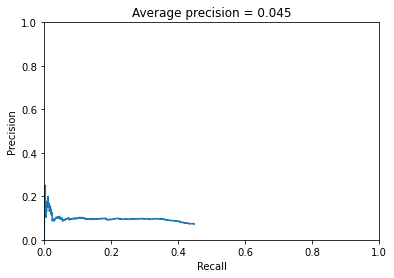

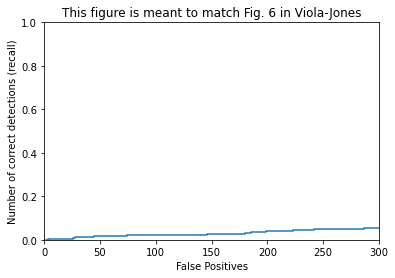

In [75]:
#label_path = '/Users/park/Desktop/vision_project/test_result.pkl'
import utils2

label_path = '/Users/park/Desktop/vision_project/test2.txt'

evaluate_detections(bboxes,confidences,image_ids, label_path)

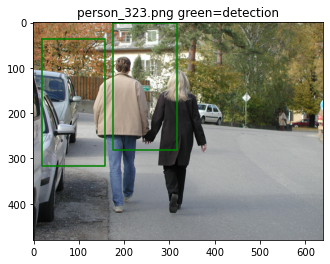

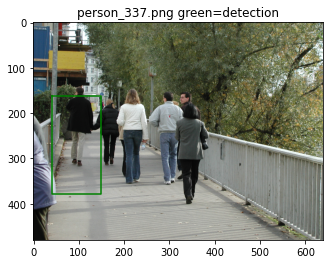

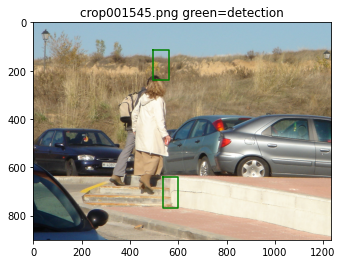

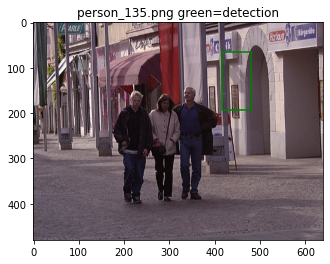

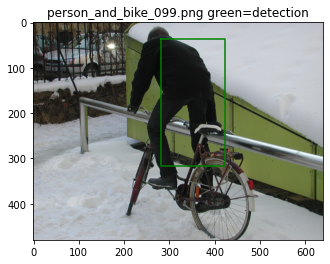

...

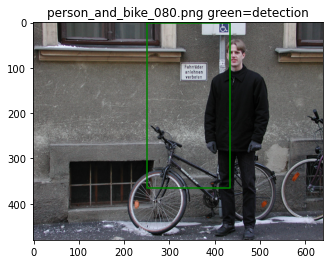

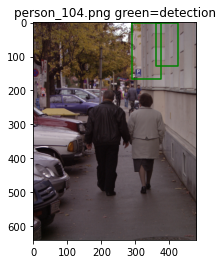

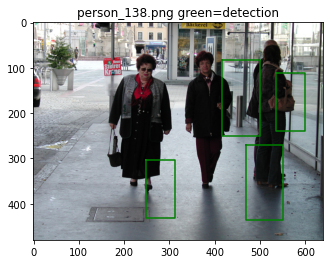

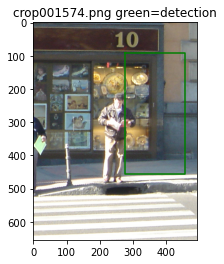

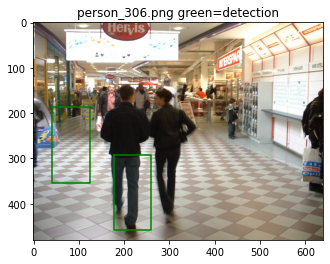

In [72]:
visualize_detections_by_image_no_gt(bboxes,confidences,image_ids,test_scn_path)